In [66]:
import numpy as np
import pandas as pd
import statistics
from matplotlib import pyplot as plt

In [67]:
df=pd.read_csv('california_housing_train.csv')
print(df.head())


   longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
0    -114.31     34.19                15.0       5612.0          1283.0   
1    -114.47     34.40                19.0       7650.0          1901.0   
2    -114.56     33.69                17.0        720.0           174.0   
3    -114.57     33.64                14.0       1501.0           337.0   
4    -114.57     33.57                20.0       1454.0           326.0   

   population  households  median_income  median_house_value  
0      1015.0       472.0         1.4936             66900.0  
1      1129.0       463.0         1.8200             80100.0  
2       333.0       117.0         1.6509             85700.0  
3       515.0       226.0         3.1917             73400.0  
4       624.0       262.0         1.9250             65500.0  


In [68]:
y_train=np.array(df['median_house_value'])
print(y_train)
array=np.array(df.drop(['median_house_value'],axis=1)).T
for i in range(len(array)):
    array[i]=(array[i]-np.mean(array[i]))/np.std(array[i])
x_train=array.T
print(x_train)

[ 66900.  80100.  85700. ... 103600.  85800.  94600.]
[[ 2.619365   -0.67152023 -1.07967114 ... -0.36118401 -0.07599796
  -1.25254316]
 [ 2.53956878 -0.57326437 -0.76187201 ... -0.26186523 -0.09940441
  -1.08148298]
 [ 2.4946834  -0.90546278 -0.92077158 ... -0.95535424 -0.99925206
  -1.17010515]
 ...
 [-2.36291168  2.90780067 -0.92077158 ... -0.16167524 -0.11760942
  -0.44666313]
 [-2.36291168  2.88908527 -0.76187201 ... -0.1146295  -0.06039367
  -0.99778717]
 [-2.387848    2.29955006  1.85997083 ... -0.54326844 -0.60134255
  -0.45536288]]


In [69]:
def loss(y_pred, y_true):
    return np.mean((y_pred - y_true) ** 2)


In [70]:
def y_prediction(x, a, b):
    return np.dot(x, a) + b


In [71]:
def grad(x, a, b, y_true):
    m = len(y_true)
    y_pred = y_prediction(x, a, b)
    da = (1 / m) * np.dot((y_pred - y_true), x)
    db = np.mean(y_pred - y_true)
    return da, db


In [72]:
def gradient_derivative(x, y_true, learning_rate, epochs):
    m, n = x.shape
    a = np.random.normal(0, 0.5, size=(n,)) * np.sqrt(2 / n)  # Initialize weights
    b = 0  # Initialize bias
    loss_mse = []

    for epoch in range(epochs):
        derivative_a, derivative_b = grad(x, a, b, y_true)
        a -= learning_rate * derivative_a
        b -= learning_rate * derivative_b
        mse = loss(y_prediction(x, a, b), y_true)
        loss_mse.append(mse)
        print("Epoch ",epoch+1," Completed!","loss = ",mse)
    print("Training completed!!")

    assert(a.shape==(n,))

    return (loss_mse,a,b)


In [73]:
epochs = 200000                                                 
learn_rate = 0.00001        
train_loss,a,b = gradient_derivative(x_train, y_train, learn_rate, epochs)
weights=pd.DataFrame(a)
weights.columns=["Weights"]
print("The value of weights is:")
print(weights)
print(f"The value of constant is: {b}")


Epoch  1  Completed! loss =  56424092113.942
Epoch  2  Completed! loss =  56423088235.4086
Epoch  3  Completed! loss =  56422084377.11335
Epoch  4  Completed! loss =  56421080539.05586
Epoch  5  Completed! loss =  56420076721.23568
Epoch  6  Completed! loss =  56419072923.652374
Epoch  7  Completed! loss =  56418069146.30556
Epoch  8  Completed! loss =  56417065389.194786
Epoch  9  Completed! loss =  56416061652.31964
Epoch  10  Completed! loss =  56415057935.67969
Epoch  11  Completed! loss =  56414054239.27453
Epoch  12  Completed! loss =  56413050563.10373
Epoch  13  Completed! loss =  56412046907.16686
Epoch  14  Completed! loss =  56411043271.4635
Epoch  15  Completed! loss =  56410039655.99324
Epoch  16  Completed! loss =  56409036060.75565
Epoch  17  Completed! loss =  56408032485.750305
Epoch  18  Completed! loss =  56407028930.9768
Epoch  19  Completed! loss =  56406025396.434685
Epoch  20  Completed! loss =  56405021882.12356
Epoch  21  Completed! loss =  56404018388.042984
E

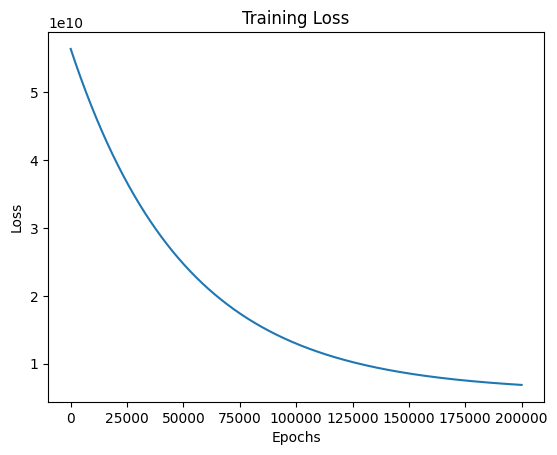

In [74]:
plt.plot([i for i in range(epochs)], train_loss)
plt.title("Training Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.show()


In [75]:
test_df=pd.read_csv('california_housing_test.csv')
print(test_df.head())

   longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
0    -122.05     37.37                27.0       3885.0           661.0   
1    -118.30     34.26                43.0       1510.0           310.0   
2    -117.81     33.78                27.0       3589.0           507.0   
3    -118.36     33.82                28.0         67.0            15.0   
4    -119.67     36.33                19.0       1241.0           244.0   

   population  households  median_income  median_house_value  
0      1537.0       606.0         6.6085            344700.0  
1       809.0       277.0         3.5990            176500.0  
2      1484.0       495.0         5.7934            270500.0  
3        49.0        11.0         6.1359            330000.0  
4       850.0       237.0         2.9375             81700.0  


In [76]:
y_test=np.array(test_df['median_house_value'])
print(y_test)
array_test=np.array(test_df.drop(['median_house_value'],axis=1)).T
for i in range(len(array_test)):
    array_test[i]=(array_test[i]-np.mean(array_test[i]))/np.std(array_test[i])
x_test=array_test.T
print(x_test)

[344700. 176500. 270500. ...  62000. 162500. 500001.]
[[-1.23372874  0.81463305 -0.14699983 ...  0.13024561  0.31773437
   1.51074547]
 [ 0.64634391 -0.64593087  1.12756514 ... -0.57629585 -0.58274291
  -0.11232419]
 [ 0.89200673 -0.87135553 -0.14699983 ...  0.07880784  0.01392592
   1.0711495 ]
 ...
 [-0.05554988  0.31212392 -1.5012251  ... -0.68887663 -0.73875265
  -0.81855768]
 [ 1.2379401  -0.72107242  0.88858421 ... -1.31680565 -1.30257733
  -0.2893275 ]
 [-0.02045519 -0.57078932  1.04790483 ... -0.63064519 -0.62927213
   2.56365089]]


In [77]:
epochs = 200000                                                 
learn_rate = 0.00001        
test_loss,a,b = gradient_derivative(x_test, y_test, learn_rate, epochs)
weights_test=pd.DataFrame(a)
weights_test.columns=["Weights"]
print("The value of weights is:")
print(weights_test)
print(f"The value of constant is: {b}")

Epoch  1  Completed! loss =  55163481541.85433
Epoch  2  Completed! loss =  55162499761.30112
Epoch  3  Completed! loss =  55161518000.86288
Epoch  4  Completed! loss =  55160536260.53915
Epoch  5  Completed! loss =  55159554540.32952
Epoch  6  Completed! loss =  55158572840.2335
Epoch  7  Completed! loss =  55157591160.25069
Epoch  8  Completed! loss =  55156609500.38061
Epoch  9  Completed! loss =  55155627860.62281
Epoch  10  Completed! loss =  55154646240.97685
Epoch  11  Completed! loss =  55153664641.44229
Epoch  12  Completed! loss =  55152683062.018684
Epoch  13  Completed! loss =  55151701502.70558
Epoch  14  Completed! loss =  55150719963.50254
Epoch  15  Completed! loss =  55149738444.40908
Epoch  16  Completed! loss =  55148756945.42481
Epoch  17  Completed! loss =  55147775466.54923
Epoch  18  Completed! loss =  55146794007.78193
Epoch  19  Completed! loss =  55145812569.122444
Epoch  20  Completed! loss =  55144831150.57032
Epoch  21  Completed! loss =  55143849752.12514


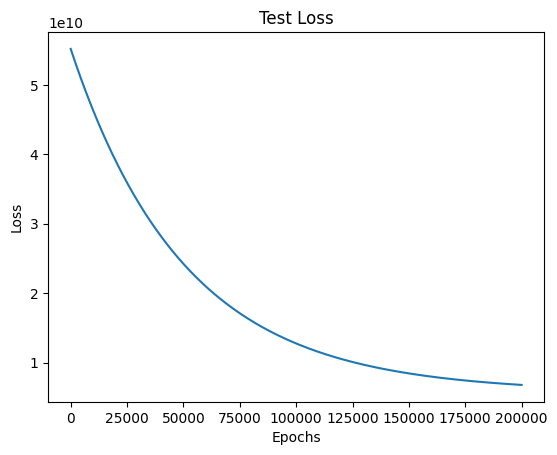

In [78]:
plt.plot([i for i in range(epochs)], test_loss)
plt.title("Test Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.show()